In [66]:
%matplotlib inline


DCGAN Tutorial
==============

**Author**: `Nathan Inkawhich <https://github.com/inkawhich>`__


Introduction
------------
Aqui veremos como y para que usar las Redes de Transformadores Espaciales(STN, por si siglas en ingles) 

entrenará una red adversarial generativa (GAN) para generar nuevos
celebridades después de mostrarle fotos de muchas celebridades reales.

Y usaremos nuestro transformador especial (STN) para tener una red neuronal que aprenda a realizar funciones espaciales como transformaciones en la imagen de entrada para mejorar la geometría invariancia del modelo

Redes adversarias generativas
-------------------------------

¿Qué es una GAN?
~~~~~~~~~~~~~~

Los GAN son un marco para enseñar un modelo DL para capturar el entrenamiento
distribución de datos para que podamos generar nuevos datos a partir de ese mismo
distribución. Las GAN fueron inventadas por Ian Goodfellow en 2014 y por primera vez
descrito en el documento `Generative Adversarial
Nets <https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf>`__.
Están hechos de dos modelos distintos, un *generador* y un
*discriminado*. El trabajo del generador es generar imágenes 'falsas' que
parecerse a las imágenes de entrenamiento. El trabajo del discriminador es mirar
en una imagen y salida si es o no una imagen de entrenamiento real o una
imagen falsa del generador. Durante el entrenamiento, el generador está
tratando constantemente de burlar al discriminador generando mejores y
mejores falsificaciones, mientras que el discriminador está trabajando para convertirse en un mejor
detective y clasificar correctamente las imágenes reales y falsas. los
equilibrio de este juego es cuando el generador está generando perfecto
falsificaciones que parecen provenir directamente de los datos de entrenamiento, y el
Se deja que el discriminador adivine siempre con un 50% de confianza que el
la salida del generador es real o falsa.

Ahora, definamos alguna notación que se usará a lo largo del tutorial comenzando
con el discriminador. Sean $x$ los datos que representan una imagen.
$D(x)$ es la red discriminadora que genera el (escalar)
probabilidad de que $x$ provenga de datos de entrenamiento en lugar de la
generador. Aquí, dado que estamos tratando con imágenes, la entrada a
$D(x)$ es una imagen de tamaño CHW 3x64x64. Intuitivamente, $D(x)$
debe ser ALTO cuando $x$ proviene de datos de entrenamiento y BAJO cuando
$x$ proviene del generador. También se puede pensar en $D(x)$
como un clasificador binario tradicional.

Para la notación del generador, sea $z$ un vector espacial latente
muestreada a partir de una distribución normal estándar. $G(z)$ representa el
función generadora que asigna el vector latente $z$ al espacio de datos.
El objetivo de $G$ es estimar la distribución que el entrenamiento
los datos provienen de ($p_{data}$) por lo que puede generar muestras falsas de
esa distribución estimada ($p_g$).

Entonces, $D(G(z))$ es la probabilidad (escalar) de que la salida del
generador $G$ es una imagen real. Como se describe en 'Goodfellow's
artículo <https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf>`__,
$D$ y $G$ juegan un juego minimax en el que $D$ intenta
maximizar la probabilidad de que clasifique correctamente los reales y los falsos
($logD(x)$), y $G$ intenta minimizar la probabilidad de que
$D$ predecirá que sus resultados son falsos ($log(1-D(G(z)))$).
Del artículo, la función de pérdida de GAN es

\begin{align}\underset{G}{\text{min}} \underset{D}{\text{max}}V(D,G) = \mathbb{E}_{x\sim p_{data} (x)}\grande[logD(x)\grande] + \mathbb{E}_{z\sim p_{z}(z)}\grande[log(1-D(G(z)))\grande ]\end{alinear}

En teoría, la solución a este juego minimax es donde
$p_g = p_{datos}$, y el discriminador adivina aleatoriamente si el
las entradas son reales o falsas. Sin embargo, la teoría de la convergencia de las GAN es
todavía se está investigando activamente y, en realidad, los modelos no siempre
entrenar hasta este punto.
~~~~~~~~~~~~~~

¿Qué es un DCGAN?
~~~~~~~~~~~~~~~~

Una DCGAN es una extensión directa de la GAN descrita anteriormente, excepto que
usa explícitamente capas convolucionales y transpuestas convolucionales en el
discriminador y generador, respectivamente. Fue descrita por primera vez por
Radford et. Alabama. en el artículo `Unsupervised Representation Learning With
Deep Convolutional Generative Adversarial
Networks <https://arxiv.org/pdf/1511.06434.pdf>`__. el discriminador
se compone de zancadas
`convolution <https://pytorch.org/docs/stable/nn.html#torch.nn.Conv2d>`__
capas, `batch
norma <https://pytorch.org/docs/stable/nn.html#torch.nn.BatchNorm2d>`__
capas, y
`LeakyReLU <https://pytorch.org/docs/stable/nn.html#torch.nn.LeakyReLU>`__
activaciones. La entrada es una imagen de entrada de 3x64x64 y la salida es una
probabilidad escalar de que la entrada sea de la distribución de datos reales.
El generador está compuesto por
`convolutional-transpose <https://pytorch.org/docs/stable/nn.html#torch.nn.ConvTranspose2d>`__
capas, capas de normas por lotes y
`ReLU <https://pytorch.org/docs/stable/nn.html#relu>`__ activaciones. los
entrada es un vector latente, $z$, que se extrae de un estándar
distribución normal y la salida es una imagen RGB de 3x64x64. el de zancadas
Las capas conv-transpose permiten que el vector latente se transforme en un
volumen con la misma forma que una imagen. En el artículo, los autores también
dar algunos consejos sobre cómo configurar los optimizadores, cómo calcular el
funciones de pérdida y cómo inicializar los pesos del modelo, todo lo cual
se explicará en las próximas secciones.
~~~~~~~~~~~~~~

¿Qué es un STN?
~~~~~~~~~~~~~~
Las redes espaciales de transformadores son una generalización de
diferenciables atención a cualquier transformación espacial. Redes de
transformadores espaciales (STN para abreviar) permiten que una red neuronal
aprenda a realizar funciones espaciales transformaciones en la imagen de
entrada para mejorar la geometría invariancia del modelo. Por ejemplo, puede
recortar una región de interés, escalar y corregir la orientación de una
imagen. Puede ser un mecanismo útil porque las CNN no son invariantes a la
rotación y la escala y son afines más generales transformaciones.

Una de las mejores cosas de STN es la capacidad de simplemente conectarlo a
cualquier CNN existente con muy pocas modificaciones. 
~~~~~~~~~~~~~~

In [67]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.nn.functional as F
import torch.utils.data
from torchvision import datasets, transforms

import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


import torchvision

from torchvision import datasets, transforms

plt.ion()   # modo interactivo

# Establecer semilla aleatoria para la reproducibilidad
manualSeed = 999
# manualSeed = random.randint(1, 10000) # usar si quieres nuevos resultados
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


Entradas
------

Definamos algunas entradas para la ejecución:

- **dataroot**: la ruta a la raíz de la carpeta del conjunto de datos. Lo haremos
   hable más sobre el conjunto de datos en la siguiente sección
- **workers**: la cantidad de subprocesos de trabajo para cargar los datos con
   el cargador de datos
- **batch_size**: el tamaño del lote utilizado en el entrenamiento. El documento DCGAN
   utiliza un tamaño de lote de 128
- **image_size**: el tamaño espacial de las imágenes utilizadas para el entrenamiento.
   Esta implementación por defecto es 64x64. Si se desea otro tamaño,
   las estructuras de D y G deben cambiarse. Ver
   `aquí <https://github.com/pytorch/examples/issues/70>`__ para más
   detalles
- **nc** - número de canales de color en las imágenes de entrada. para el color
   imágenes esto es 3
- **nz** - longitud del vector latente
- **ngf** - se relaciona con la profundidad de los mapas de características llevados a través del
   generador
- **ndf**: establece la profundidad de los mapas de características que se propagan a través del
   discriminado
- **num_epochs** - número de épocas de entrenamiento a ejecutar. Entrenamiento para
   más tiempo probablemente conducirá a mejores resultados, pero también llevará mucho
   más extenso
- **lr** - tasa de aprendizaje para el entrenamiento. Como se describe en el documento DCGAN,
   este número debe ser 0.0002
- **beta1** - Hiperparámetro beta1 para optimizadores de Adam. Como se describe en
   papel, este número debe ser 0.5
- **ngpu** - número de GPU disponibles. Si esto es 0, el código se ejecutará en
   modo CPU. Si este número es mayor que 0, se ejecutará en ese número
   de GPU

In [68]:
# Directorio raíz para el conjunto de datos
dataroot = "celeba"

# Número de trabajadores para el cargador de datos
workers = 2

# Tamaño del lote durante el entrenamiento
batch_size = 128

# Tamaño espacial de las imágenes de entrenamiento.  Todas las imágenes serán redimensionadas a este
# tamaño usando un transform
image_size = 64

# Número de canales en las imágenes de entrenamiento.  Para imágenes en color esto es 3
nc = 3

# Tamaño del vector latente z (es decir, tamaño de la entrada del generador)
nz = 100

# Tamaño de los mapas de características en el generador
ngf = 64

# Tamaño de mapas de características en discriminador
ndf = 64

# Número de épocas de entrenamiento
num_epochs = 15

# Tasa de aprendizaje para optimizadores
lr = 0.0002

# Hiperparámetro Beta1 para optimizadores de Adam
beta1 = 0.5

# Número de GPU disponibles.  Utilice 0 para el modo de CPU.
ngpu = 1

Datos
----

En este tutorial usaremos el `Celeb-A Faces
dataset <http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html>`__ Puede
ser descargado en el sitio enlazado, o en `Google
Drive <https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg>`__.
El conjunto de datos se descargará como un archivo llamado *img_align_celeba.zip*.  Una vez
descargado, cree un directorio llamado *celeba* y extraiga el archivo zip
en ese directorio.  Luego, configure la entrada *dataroot* para este cuaderno en
el directorio *celeba* que acaba de crear.  El directorio resultante
estructura debe ser:

::

   /path/to/celeba
       -> img_align_celeba  
           -> 188242.jpg
           -> 173822.jpg
           -> 284702.jpg
           -> 537394.jpg
              ...

Este es un paso importante porque usaremos ImageFolder
clase de conjunto de datos, que requiere que haya subdirectorios en el
carpeta raíz del conjunto de datos.  Ahora, podemos crear el conjunto de datos, crear el
cargador de datos, configure el dispositivo para que se ejecute y finalmente visualice algunos de los
datos de entrenamiento.

In [69]:
#from google.colab import drive
 
#drive.mount('/content/drive')

#!cp drive/MyDrive/"Colab Notebooks"/celeba.zip .

#!unzip celeba.zip

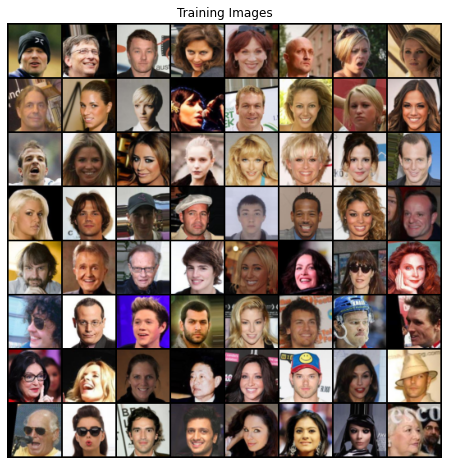

In [70]:
# Podemos usar un conjunto de datos de carpetas de imágenes de la forma en que lo tenemos configurado.
# Crear el conjunto de datos
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Crear el cargador de datos
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decidir en qué dispositivo queremos ejecutar
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Trazar algunas imágenes de entrenamiento
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))


### Representación de redes de transformadores espaciales
Las redes de transformadores espaciales se reducen a tres componentes principales:

- La red de localización es una CNN regular que retrocede el parámetros de transformación. La transformación nunca se aprende explícitamente de este conjunto de datos, en cambio, la red aprende automáticamente las transformaciones espaciales que mejoran la precisión global.
- El generador de grillas genera una grilla de coordenadas en la entrada imagen correspondiente a cada píxel de la imagen de salida. 
- El muestreador usa los parámetros de la transformación y aplica a la imagen de entrada. 

![stn](https://pytorch.org/tutorials/_images/stn-arch.png)

Implementación
--------------

Con nuestros parámetros de entrada establecidos y el conjunto de datos preparado, ahora podemos obtener
en la implementación.  Comenzaremos con la inicialización del peso.
estrategia, luego hable sobre el generador, el discriminador, las funciones de pérdida,
y bucle de entrenamiento en detalle.


Inicialización de peso
 ~~~~~~~~~~~~~~~~~~~~~

Del documento DCGAN, los autores especifican que todos los pesos del modelo deben
inicializarse aleatoriamente a partir de una distribución Normal con media=0,
desvst=0.02.  La función ``weights_init`` toma un modelo inicializado como
entrada y reinicializa todas las funciones convolucionales, de transposición convolucional y
capas de normalización por lotes para cumplir con este criterio.  Esta función es
aplicado a los modelos inmediatamente después de la inicialización.


In [71]:
# inicialización de pesos personalizados llamada en netG y netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

Generador
~~~~~~~~~

El generador, $G$, está diseñado para mapear el vector espacial latente
($z$) al espacio de datos. Dado que nuestros datos son imágenes, convertir
$z$ al espacio de datos significa, en última instancia, crear una imagen RGB con el
mismo tamaño que las imágenes de entrenamiento (es decir, 3x64x64). En la práctica, esto es
logrado a través de una serie de convoluciones bidimensionales con zancadas
capas de transposición, cada una emparejada con una capa de norma de lote 2d y una relu
activación. La salida del generador se alimenta a través de una función tanh
para devolverlo al rango de datos de entrada de $[-1,1]$. Vale la pena
observando la existencia de las funciones de norma de lote después de la
conv-transpose capas, ya que esta es una contribución crítica de DCGAN
papel. Estas capas ayudan con el flujo de gradientes durante el entrenamiento. Un
La imagen del generador del documento DCGAN se muestra a continuación.

.. figure:: /_static/img/dcgan_generator.png
   :alt: dcgan_generator

Observe cómo las entradas que configuramos en la sección de entrada (*nz*, *ngf* y
*nc*) influyen en la arquitectura del generador en el código.  *nz* es la longitud
del vector de entrada z, *ngf* se relaciona con el tamaño de los mapas de características
que se propagan a través del generador, y *nc* es el número de
canales en la imagen de salida (ajustado a 3 para imágenes RGB).  abajo esta el
código para el generador.




In [72]:
# Código del generador

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # la entrada es Z, entrando en una convolución
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            
            #tamaño del estado. (ngf*8)x4x4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            # tamaño del estado. (ngf*4)x8x8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            # tamaño del estado. (ngf*2)x16x16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            # tamaño del estado. (ngf)x32x32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # tamaño del estado. (nc)x64x64
        )
        ##################STN##################
        # Red de localización de transformadores espaciales
        self.localization = nn.Sequential(
            
            #nn.Conv2d(canales de entrada, canales de salida, tamaño del kernel)
            nn.Conv2d(nz, ngf * 8, kernel_size=1),
            
            nn.MaxPool2d(1, stride=1), # Si usamos un MaxPool de "2" da error de dimension ((512x0x0))
            nn.ReLU(True),
            
            #nn.Conv2d(canales de entrada, canales de salida, tamaño del kernel)
            nn.Conv2d(ngf * 8, 1, kernel_size=1),
            #No usamos una capa MaxPool2d por que daria problemas de dimesiones

            nn.MaxPool2d(1, stride=1), # # Si usamos un MaxPool de "2" da error de dimension ((512x0x0))
        )

        # Regresor para la matriz afín 3 * 2
        self.fc_loc = nn.Sequential(
            #nn.Linear(canales de entrada, canales de salida)
            nn.Linear(1, 32),
            nn.ReLU(True),
            #nn.Linear(canales de entrada, canales de salida)
            nn.Linear(32, 3 * 2)
        )
        
        # Inicializar los pesos/sesgo con transformación de identidad
        self.fc_loc[2].weight.data.zero_()
        self.fc_loc[2].bias.data.copy_(torch.tensor([1, 0, 0, 0, 1, 0], dtype=torch.float))
    
    # Función de reenvío de red de transformador espacial
    def stn(self, x):
        xs = self.localization(x)
        # Cambiamos la forma del tensor para que tenga "128"(-1) columnas y "1" fila(1)
        xs = xs.view(-1, 1)
        theta = self.fc_loc(xs)
        #  Cambiamos la forma del tensor para que tenga "128"(-1), "2"(2), y "3"(3)
        theta = theta.view(-1, 2, 3)#Dabe tener esta forma para aplicar la funcion "F.affine_grid"

        grid = F.affine_grid(theta, x.size())
        x = F.grid_sample(x, grid)

        return x
        ##################STN##################

    def forward(self, input):
      # transforma la entrada
      x = self.stn(input)
      
      # Realizar el pase hacia adelante habitual
      return self.main(x)

Ahora, podemos instanciar el generador y aplicar ``weights_init``
 función.  Mira el modelo impreso para ver cómo es el objeto generador.
 estructurado.

In [73]:
# Crea el generador
netG = Generator(ngpu).to(device)

# Manejar multi-gpu si lo desea
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Aplicar la función weights_init para inicializar aleatoriamente todos los pesos
# a media=0, desviación estándar=0.02
netG.apply(weights_init)

# Imprime el modelo
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
  

Discriminator
~~~~~~~~~~~~~

Como se mencionó, el discriminador, $D$, es una clasificación binaria
red que toma una imagen como entrada y genera una probabilidad escalar
que la imagen de entrada es real (en lugar de falsa). Aquí, $D$ toma
una imagen de entrada de 3x64x64, la procesa a través de una serie de Conv2d,
capas BatchNorm2d y LeakyReLU, y genera la probabilidad final
a través de una función de activación sigmoidea. Esta arquitectura puede extenderse
con más capas si es necesario para el problema, pero hay importancia
al uso de la convolución estriada, BatchNorm y LeakyReLUs. los
El documento de DCGAN menciona que es una buena práctica usar convolución estriada
en lugar de agrupar para reducir la muestra porque permite que la red aprenda su
propia función de agrupación. También la norma por lotes y las funciones de relu con fugas promueven
flujo de gradiente saludable que es fundamental para el proceso de aprendizaje de ambos
$G$ y $D$.




Código discriminador

In [74]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # la entrada es (nc)x64x64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            # tamaño del estado. (ndf)x32x32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            
            # tamaño del estado. (ndf*2)x16x16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            # tamaño del estado. (ndf*4)x8x8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            
            # tamaño del estado. (ndf*8)x4x4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
       ##################STN##################
        # Red de localización de transformadores espaciales
        self.localization = nn.Sequential(
            
            #nn.Conv2d(Numero de canales de color, Maspas de caracteristicas, kernel_size=1)
            #Salida = [2048, 3] 
            nn.Conv2d(nc, ngf, kernel_size=1),
            
            #Ponemos nuestros datos en un MaxPool2 (esto dividira nuestros datos entr 4)
            #Salida = [512, 3].
            nn.MaxPool2d(2, stride=2),

            nn.ReLU(True),
            
            #nn.Conv2d(Numero de canales de color, Maspas de caracteristicas, kernel_size=1)
            #Salida = [512, 3]
            nn.Conv2d(ngf, 64, kernel_size=1),
            
            #Ponemos nuestros datos en un MaxPool2 (esto dividira nuestros datos entr 4)
            #Salida = #[128, 3]
            nn.MaxPool2d(2, stride=2),        
        )

        # Regresor para la matriz afín 3 * 2
        self.fc_loc = nn.Sequential(
            # Entablecemos nuestra entrada de capa lineal para que coincida con la forma de "xs":
            # nn.Linear(profundidad de los mapas de características*alto de imagen*ancho de imagen, 32)
            nn.Linear(ndf * 16 * 16, 32),
            nn.ReLU(True),
            nn.Linear(32, 3 * 2)# damos una salida de 3*2(para posteriormente cambiar su forma en "theta")
        )
        
        ## Inicializar los pesos/sesgo con transformación de identidad
        self.fc_loc[2].weight.data.zero_()
        self.fc_loc[2].bias.data.copy_(torch.tensor([1, 0, 0, 0, 1, 0], dtype=torch.float))
    
    # Función de reenvío de red de transformador espacial
    def stn(self, x):
        xs = self.localization(x)
        # Cambiamos la forma del tensor para que tenga "128"(-1) columnas y "2,048" filas(profundidad de los mapas de características*alto de imagen*ancho de imagen)
        xs = xs.view(-1, ndf * 16 * 16)
        theta = self.fc_loc(xs)
        #  Cambiamos la forma del tensor para que tenga "128"(-1) columnas ""(2) fila y ""(3)
        theta = theta.view(-1, 2, 3) #Dabe tener esta forma para aplicar la funcion "F.affine_grid"

        grid = F.affine_grid(theta, x.size())

        x = F.grid_sample(x, grid)

        return x
        ##################STN##################
    
    def forward(self, input):
      x = self.stn(input)
      return self.main(input)

Ahora, como con el generador, podemos crear el discriminador, aplicar el
 función ``weights_init`` e imprime la estructura del modelo.

In [75]:
# Crear el Discriminador
netD = Discriminator(ngpu).to(device)

# Manejar multi-gpu si lo desea
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Aplicar la función weights_init para inicializar aleatoriamente todos los pesos
# a media=0, desviación estándar=0,2.
netD.apply(weights_init)

# Imprime el modelo
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
  (localization): Sequential(
  

Funciones de pérdida y optimizadores
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Con la configuración de $D$ y $G$, podemos especificar cómo aprenden
a través de las funciones de pérdida y optimizadores.  Usaremos la Cruz Binaria
pérdida de entropía
(`Pérdida de BCEL <https://pytorch.org/docs/stable/nn.html#torch.nn.Pérdida de BCEL>`__)
 función que se define en PyTorch como:

\begin{align}\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]\end{align}

Observe cómo esta función proporciona el cálculo de ambos componentes de registro
en la función objetivo (es decir, $log(D(x))$ y
$registro(1-D(G(z)))$). Podemos especificar qué parte de la ecuación BCE
usar con la entrada $y$. Esto se logra en el ciclo de entrenamiento.
que vendrá pronto, pero es importante entender cómo podemos
elegir qué componente deseamos calcular simplemente cambiando $y$
(es decir, etiquetas GT).

A continuación, definimos nuestra etiqueta real como 1 y la etiqueta falsa como 0. Estos
etiquetas se utilizarán al calcular las pérdidas de $D$ y
$G$, y esta es también la convención utilizada en el GAN ​​original
papel.  Finalmente, configuramos dos optimizadores separados, uno para $D$ y
uno por $G$.  Como se especifica en el documento DCGAN, ambos son Adam
optimizadores con tasa de aprendizaje 0.0002 y Beta1 = 0.5.  Para hacer un seguimiento
de la progresión de aprendizaje del generador, generaremos un lote fijo
de vectores latentes que se extraen de una distribución gaussiana
(es decir, fixed_noise/ruido_fijo) .  En el ciclo de entrenamiento, introduciremos periódicamente
este fixed_noise en $G$, y sobre las iteraciones veremos
las imágenes se forman a partir del ruido.




In [76]:
# Inicializa la función BCELoss
criterion = nn.BCELoss()

# Crear un lote de vectores latentes que usaremos para visualizar
# la progresión del generador
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establecer convención para etiquetas reales y falsas durante el entrenamiento
real_label = 1.
fake_label = 0.

# Configure los optimizadores Adam para G y D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

Entrenamiento
~~~~~~~~

Finalmente, ahora que tenemos todas las partes del marco GAN definidas,
podemos entrenarlo.  Tenga en cuenta que entrenar GAN es algo así como un arte
formulario, ya que la configuración incorrecta de hiperparámetros conduce al colapso del modo con
poca explicación de lo que salió mal.  Aquí seguiremos de cerca
Algoritmo 1 del artículo de Goodfellow, respetando algunos de los mejores
prácticas que se muestran en `ganhacks <https://github.com/soumith/ganhacks>`__.
Es decir, "construiremos diferentes mini-batches reales y falsos"
imágenes, y también ajustar la función objetivo de G para maximizar
$logD(G(z))$.  La formación se divide en dos partes principales.  Parte 1
actualiza el Discriminador y la Parte 2 actualiza el Generador.

**Parte 1 - Capacitar al discriminador**

Recuerde, el objetivo de entrenar al discriminador es maximizar la
probabilidad de clasificar correctamente una entrada determinada como real o falsa.  En
términos de Goodfellow, deseamos “actualizar el discriminador ascendiendo
su gradiente estocástico”.  Prácticamente, queremos maximizar
$registro(D(x)) + registro(1-D(G(z)))$.  Debido al mini lote separado
sugerencia de ganhacks, calcularemos esto en dos pasos.  Primero nosotros
construirá un lote de muestras reales del conjunto de entrenamiento, adelante
pasar a través de $D$, calcular la pérdida ($log(D(x))$), luego
calcular los gradientes en una pasada hacia atrás.  En segundo lugar, construiremos
un lote de muestras falsas con el generador actual, adelante pasa esto
lote a través de $D$, calcule la pérdida ($log(1-D(G(z)))$),
y *acumular* los gradientes con un pase hacia atrás.  Ahora, con el
gradientes acumulados tanto de los lotes reales como de los falsos,
llamar a un paso del optimizador del Discriminad

**Parte 2: entrenar al generador**

Como se indica en el artículo original, queremos entrenar al Generador
minimizando $log(1-D(G(z)))$ en un esfuerzo por generar mejores falsificaciones.
Como se mencionó, Goodfellow demostró que esto no proporciona suficiente
gradientes, especialmente al principio del proceso de aprendizaje. Como solución, nosotros
en su lugar desea maximizar $log(D(G(z)))$. En el código logramos
esto: clasificando la salida del Generador de la Parte 1 con el
Discriminador, computando la pérdida de G *usando etiquetas reales como GT*, computando
Gradientes de G en un paso hacia atrás, y finalmente actualizando los parámetros de G
con un paso optimizador. Puede parecer contrario a la intuición utilizar el real
etiquetas como etiquetas GT para la función de pérdida, pero esto nos permite usar el
$log(x)$ parte de BCELoss (en lugar de $log(1-x)$
parte) que es exactamente lo que queremos.

Finalmente, haremos algunos informes estadísticos y al final de cada
época empujaremos nuestro lote de ruido fijo a través del generador para
seguir visualmente el progreso del entrenamiento de G. Las estadísticas de entrenamiento
reportados son:

**Parte 3: entrenar al STN**
la idea es que la red aprenda la tarea de clasificación de forma supervisada.
Al mismo tiempo el modelo está aprendiendo STN automáticamente de forma integral

- **Loss_D** - pérdida del discriminador calculada como la suma de pérdidas para
    todos los lotes reales y falsos ($log(D(x)) + log(1 - D(G(z)))$).
- **Loss_G** - pérdida del generador calculada como $log(D(G(z)))$
- **D(x)** - la salida promedio (a través del lote) del discriminador
    para el lote todo real. Esto debería comenzar cerca de 1 entonces
    teóricamente convergen a 0.5 cuando G mejora. Piensa en por qué
    esto es.
- **D(G(z))** - salidas promedio del discriminador para el lote falso.
    El primer número es anterior a la actualización de D y el segundo número es
    después de actualizar D. Estos números deben comenzar cerca de 0 y converger a
    0,5 a medida que G mejora. Piensa por qué es esto.

**Nota:** Este paso puede demorar un poco, según la cantidad de épocas que
ejecutar y si eliminó algunos datos del conjunto de datos.




In [77]:
# Bucle de entrenamiento

# Listas para realizar un seguimiento del progreso
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Para cada época
for epoch in range(num_epochs):
    # Para cada lote en el cargador de datos
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Actualizar red D: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Entrena con todos los lotes reales(all-real batch)
        netD.zero_grad()
        
        # Formatear lote
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        
        # Reenviar pasar lote real a través de D
        output = netD(real_cpu).view(-1)
        
        # Calcule la pérdida en un lote totalmente real(all-real batch)
        errD_real = criterion(output, label)
        
        # Calcular gradientes para D en paso hacia atrás
        errD_real.backward()
        D_x = output.mean().item()

        ## Entrena con lotes falsos
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Generar lote de imágenes falsas con G
        fake = netG(noise)
        label.fill_(fake_label)
        
        # Clasifique todos los lotes falsos con D
        output = netD(fake.detach()).view(-1)
        
        # Calcule la pérdida de D en el lote totalmente falso
        errD_fake = criterion(output, label)
        
        # Calcule los gradientes para este lote, acumulados (sumados) con gradientes anteriores
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        # Calcule el error de D como la suma de los lotes falsos y reales
        errD = errD_real + errD_fake
        
        # Actualizado D
        optimizerD.step()

        ############################
        # (2) Actualizar red G: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # etiquetas falsas son reales por el costo del generador
        
        # Ya que acabamos de actualizar D, realice otro pase hacia adelante del lote completamente falso a través de D
        output = netD(fake).view(-1)
        
        # Calcule la pérdida de G en función de esta salida
        errG = criterion(output, label)
        
        # Calcular gradientes para G
        errG.backward()
        D_G_z2 = output.mean().item()
        
        # Actualizar G
        optimizerG.step()
        
        # Estadísticas de entrenamiento de salida
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Guardar pérdidas para trazar más tarde
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Compruebe cómo está funcionando el generador guardando la salida de G en fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:4256: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  "Default grid_sample and affine_grid behavior has changed "
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:4194: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  "Default grid_sample and affine_grid behavior has changed "


[0/15][0/1583]	Loss_D: 1.7637	Loss_G: 5.0001	D(x): 0.5220	D(G(z)): 0.5646 / 0.0101
[0/15][50/1583]	Loss_D: 0.0212	Loss_G: 36.6001	D(x): 0.9819	D(G(z)): 0.0000 / 0.0000
[0/15][100/1583]	Loss_D: 0.0068	Loss_G: 25.0368	D(x): 0.9940	D(G(z)): 0.0000 / 0.0000
[0/15][150/1583]	Loss_D: 0.3513	Loss_G: 3.8859	D(x): 0.8686	D(G(z)): 0.0603 / 0.0564
[0/15][200/1583]	Loss_D: 0.8165	Loss_G: 5.2432	D(x): 0.9040	D(G(z)): 0.4322 / 0.0159
[0/15][250/1583]	Loss_D: 0.6567	Loss_G: 4.6762	D(x): 0.8519	D(G(z)): 0.3290 / 0.0158
[0/15][300/1583]	Loss_D: 0.8122	Loss_G: 5.2923	D(x): 0.6093	D(G(z)): 0.0380 / 0.0122
[0/15][350/1583]	Loss_D: 0.4001	Loss_G: 4.4783	D(x): 0.7852	D(G(z)): 0.0900 / 0.0264
[0/15][400/1583]	Loss_D: 0.8435	Loss_G: 7.3760	D(x): 0.9218	D(G(z)): 0.4431 / 0.0021
[0/15][450/1583]	Loss_D: 0.9100	Loss_G: 6.9971	D(x): 0.9375	D(G(z)): 0.4835 / 0.0028
[0/15][500/1583]	Loss_D: 0.6094	Loss_G: 3.7773	D(x): 0.6773	D(G(z)): 0.0513 / 0.0352
[0/15][550/1583]	Loss_D: 0.4744	Loss_G: 3.6728	D(x): 0.8443	D(G(z)

Resultados
-------

Finalmente, veamos cómo lo hicimos.  Aquí veremos tres
resultados diferentes.  Primero, veremos cómo cambiaron las pérdidas de D y G.
durante el entrenamiento.  En segundo lugar, visualizaremos la salida de G en fixed_noise
lote para cada época.  Y tercero, veremos un lote de datos reales
junto a un lote de datos falsos de G.

**Pérdida versus iteración de entrenamiento**

A continuación se muestra un gráfico de las pérdidas de D & G frente a las iteraciones de entrenamiento.

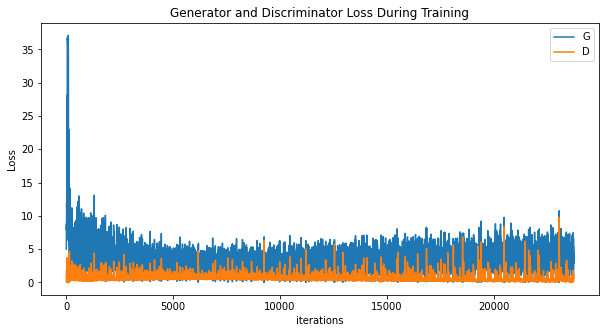

In [78]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualización de la progresión de G**

Recuerde cómo guardamos la salida del generador en el lote de ruido fijo
después de cada época de entrenamiento.  Ahora, podemos visualizar el entrenamiento.
progresión de G con una animación.  Pulse el botón de reproducción para iniciar la
animación.

Animation size has reached 21110970 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


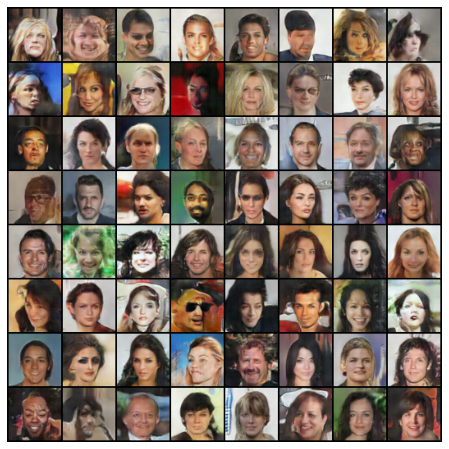

In [79]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Imágenes reales frente a imágenes falsas**

Finalmente, echemos un vistazo a algunas imágenes reales e imágenes falsas una al lado de la otra.
lado.

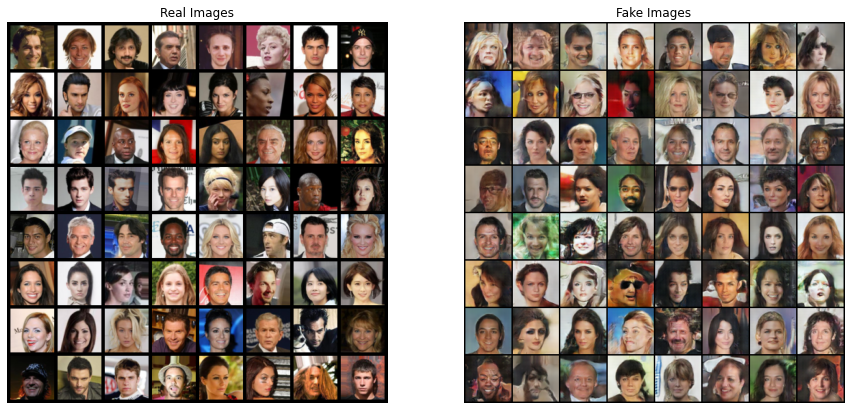

In [80]:
# Obtenga un lote de imágenes reales del cargador de datos
real_batch = next(iter(dataloader))

# Trazar las imágenes reales
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Trazar las imágenes falsas de la última época
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

Gracias A:
----------------
Documentacion oficial de pytorch: 
- https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

- https://pytorch.org/tutorials/intermediate/spatial_transformer_tutorial.html

Traducido por: Mi :)